In [1]:
from datetime import datetime
import pandas
import numpy

# Import plot making tools
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=False)
import cufflinks as cf
cf.go_offline()

In [2]:
houses = [1, 2, 4, 5, 6, 7, 8, 9, 10, 12, 13, 15, 16, 17, 18, 19, 20]  # remove 3, 11, 21 (because solar counted as loading), no 14 
# Flexible load = dishwasher
flexible_loads = {1: [6],
                  2: [3], 
                  4: [],
                  5: [4],
                  6: [3],
                  7: [6],
                  8: [],
                  9: [4],
                  10: [6],
                  12: [],
                  13: [4],
                  15: [4],
                  16: [6],  # 2 electric heaters and a Dehumidifier
                  17: [],
                  18: [6],
                  19: [],
                  20: [5],}
timestep = 5  # minutes
tmp = pandas.DataFrame()

for house in houses:
    print(house)
    raw = pandas.read_csv('CLEAN_REFIT_081116/CLEAN_House' + str(house) + '.csv', parse_dates=[0], index_col=0)
    raw = raw.loc['2014-05-01 00:00:00':'2015-05-01 00:00:00', :]
    
    # Save agg consumption
    raw['AggE'] = raw['Aggregate'].cumsum(axis=0) * 8 / 3600  # sum power every 8 seconds to kWh
    tmp['house' + str(house) + '_kW'] = raw['AggE'].resample(str(timestep) + 'T').last().diff() * 60 / timestep / 1000
    
    # Save flexible loads
    for nb in flexible_loads[house]:
        raw['flexible'] = raw['Appliance' + str(nb)].cumsum(axis=0) * 8 / 3600  # sum power every 8 seconds to kWh
        tmp['house' + str(house) + '_dishwasher' + '_kW'] = raw['flexible'].resample(str(timestep) + 'T').last().diff() * 60 / timestep / 1000

1
2
4
5
6
7
8
9
10
12
13
15
16
17
18
19
20


In [3]:
tmp.head()

,house1_kW,house1_dishwasher_kW,house2_kW,house2_dishwasher_kW,house4_kW,house5_kW,house5_dishwasher_kW,house6_kW,house6_dishwasher_kW,house7_kW,...,house15_kW,house15_dishwasher_kW,house16_kW,house16_dishwasher_kW,house17_kW,house18_kW,house18_dishwasher_kW,house19_kW,house20_kW,house20_dishwasher_kW
Time,,,,,,,,,,,,,,,,,,,,,
2014-05-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2014-05-01 00:05:00,0.277760,0.0,0.194400,0.0,0.342880,0.350507,0.005067,0.302587,0.0,0.173227,...,0.216827,0.0,0.480560,0.0,0.108507,0.148080,0.0,0.177493,0.191893,0.0
2014-05-01 00:10:00,0.359360,0.0,0.210427,0.0,0.237733,0.345093,0.004827,0.316400,0.0,0.337493,...,0.229280,0.0,0.552453,0.0,0.394800,0.199333,0.0,0.206187,0.260507,0.0
2014-05-01 00:15:00,0.332187,0.0,0.209333,0.0,0.123040,0.303040,0.004987,0.320987,0.0,0.253307,...,0.226453,0.0,0.592853,0.0,0.406773,0.250960,0.0,0.198640,0.281467,0.0
2014-05-01 00:20:00,0.221067,0.0,0.204480,0.0,0.157360,0.244427,0.004107,0.239840,0.0,0.205360,...,0.193093,0.0,0.555947,0.0,0.335813,0.200080,0.0,0.199867,0.167440,0.0


In [4]:
tmp['total_kW'] = tmp[[k for k in tmp.columns if 'dish' not in k]].sum(axis=1)
tmp['total_dishwasher_kW'] = tmp[[k for k in tmp.columns if 'dish' in k]].sum(axis=1)

In [5]:
tmp.to_csv('results/5min_houses_kW.csv')

# Verifying that the data make sense

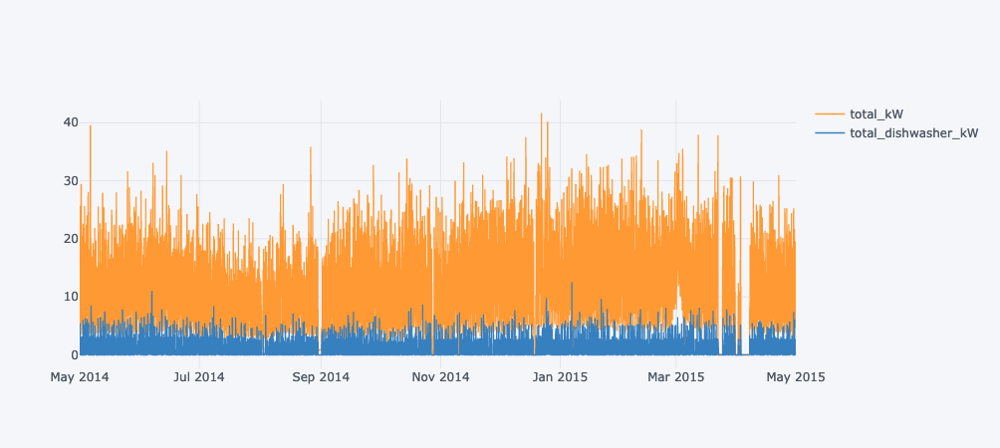

In [6]:
tmp[['total_kW', 'total_dishwasher_kW']].iplot()

In [7]:
tmp[[k for k in tmp.columns if 'dish' not in k]].sum() * timestep / 60

house1_kW      4180.522069
house2_kW      4511.070133
house4_kW      3447.741202
house5_kW      7519.944729
house6_kW      4395.195176
house7_kW      5175.482938
house8_kW      6189.261404
house9_kW      5868.448453
house10_kW     6518.034211
house12_kW     3728.333584
house13_kW     4756.322049
house15_kW     2449.816240
house16_kW     5113.365324
house17_kW     4147.666622
house18_kW     4055.540564
house19_kW     2938.089687
house20_kW     3541.879296
total_kW      78536.713682
dtype: float64

In [8]:
tmp[[k for k in tmp.columns if 'dish' in k]].sum() * timestep / 60

house1_dishwasher_kW      102.547778
house2_dishwasher_kW      592.147353
house5_dishwasher_kW      547.924367
house6_dishwasher_kW      103.229107
house7_dishwasher_kW      555.941520
house9_dishwasher_kW      501.090891
house10_dishwasher_kW     372.124962
house13_dishwasher_kW     196.268727
house15_dishwasher_kW      12.314298
house16_dishwasher_kW     248.654524
house18_dishwasher_kW     202.671358
house20_dishwasher_kW     103.910804
total_dishwasher_kW      3538.825689
dtype: float64

Dishwasher are between 2% - 10% of total energy consumption per house and 4.5% total for the 17 houses.

In [9]:
3538 * 100 / 78536

4.504940409493735

In [10]:
message = 'YREYX VIMRH MGIHE RWPEG YMWMR IGXHI PERET TI' #encrypted message
LETTERS = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'

for key in range(len(LETTERS)):
    translated = ''
    for symbol in message:
        if symbol in LETTERS:
            num = LETTERS.find(symbol)
            num = num - key
            if num < 0:
                num = num + len(LETTERS)
            translated = translated + LETTERS[num]
        else:
            translated = translated + symbol
    print('Hacking key #%s: %s' % (key, translated))

Hacking key #0: YREYX VIMRH MGIHE RWPEG YMWMR IGXHI PERET TI
Hacking key #1: XQDXW UHLQG LFHGD QVODF XLVLQ HFWGH ODQDS SH
Hacking key #2: WPCWV TGKPF KEGFC PUNCE WKUKP GEVFG NCPCR RG
Hacking key #3: VOBVU SFJOE JDFEB OTMBD VJTJO FDUEF MBOBQ QF
Hacking key #4: UNAUT REIND ICEDA NSLAC UISIN ECTDE LANAP PE
Hacking key #5: TMZTS QDHMC HBDCZ MRKZB THRHM DBSCD KZMZO OD
Hacking key #6: SLYSR PCGLB GACBY LQJYA SGQGL CARBC JYLYN NC
Hacking key #7: RKXRQ OBFKA FZBAX KPIXZ RFPFK BZQAB IXKXM MB
Hacking key #8: QJWQP NAEJZ EYAZW JOHWY QEOEJ AYPZA HWJWL LA
Hacking key #9: PIVPO MZDIY DXZYV INGVX PDNDI ZXOYZ GVIVK KZ
Hacking key #10: OHUON LYCHX CWYXU HMFUW OCMCH YWNXY FUHUJ JY
Hacking key #11: NGTNM KXBGW BVXWT GLETV NBLBG XVMWX ETGTI IX
Hacking key #12: MFSML JWAFV AUWVS FKDSU MAKAF WULVW DSFSH HW
Hacking key #13: LERLK IVZEU ZTVUR EJCRT LZJZE VTKUV CRERG GV
Hacking key #14: KDQKJ HUYDT YSUTQ DIBQS KYIYD USJTU BQDQF FU
Hacking key #15: JCPJI GTXCS XRTSP CHAPR JXHXC TRIST APCPE ET
Hacking key #16: I